# Synexpression groups identification

ID: 

Name: Iris Milligan

Last modified: 07.04.2021

## Required libraries

In [20]:
import pandas as pd
import scipy
from easygui import * # used for file selection dialogue to select Data input file
import sys
from ipywidgets import * # used for variable inputs ()
from sklearn.cluster import AgglomerativeClustering
from sklearn.metrics.pairwise import euclidean_distances
from scipy.stats import pearsonr
from scipy.cluster.hierarchy import dendrogram, linkage, set_link_color_palette
from scipy.spatial.distance import pdist, squareform
import matplotlib.pyplot as plt
from matplotlib.colors import rgb2hex, colorConverter
from mpl_toolkits.mplot3d import Axes3D
import numpy as np
from scipy import stats
from scipy.signal import find_peaks
from collections import defaultdict
import seaborn as sns
import statsmodels.api as sm
import os
import scipy.cluster.hierarchy as sch
pd.options.display.max_columns = None
pd.options.display.max_rows = None
#%pylab inline
#%matplotlib inline

In [21]:
def print_output_to_file(file_name, data_to_save, sheetName, method):
    # Print output to confirm data format
    # Create a Pandas Excel writer using XlsxWriter as the engine.
    # writer = pd.ExcelWriter(file_name, engine='xlsxwriter', mode=method)
    writer = pd.ExcelWriter(file_name, engine="openpyxl", mode=method)
    # Convert the dataframe to an XlsxWriter Excel object.
    data_to_save.to_excel(writer, sheet_name=sheetName)

    # Close the Pandas Excel writer and output the Excel file.
    writer.save()

In [22]:
def print_output_to_csv(file_name, data_to_save):
    # Print output to confirm data format
    data_to_save.to_csv(file_name)


## Section 1: Data import
## Select Source File
## Select the Sections from the Source File to process
## Build Dataframe from Source 

In [23]:

# Launch File Dialogue to select file to process
msg = "Select the *.csv file to be processed"
title = "Synexpression Source File Selection"
def1 = '*'
filetypes = ["*.csv"] # Used to only display files of this type
multiples = False # Only allow the selection of 1 file at a time

#synFilename = fileopenbox(msg, title, def1, filetypes, multiples)
#sys.exit(0)
synFilename = "TomoZF10ss.csv"
# If the Cancel Button is Selected synFilename will be null so exit program
if synFilename is None: sys.exit(0)



## Cottect the Parameters to bused for Processing the Data

In [24]:
# from ipywidgets import GridspecLayout
# Collect parameters to use for processing the data file.
# Using IpyWidgets
# gridspec = GridspecLayout(3,3)

style = {'description_width': 'initial'}
layout = {'width':'400px'}
startSec = widgets.IntText(value=1,
                           description='AP Start:',
                           disabled=False, style=style, layout=layout)
numSectsAfter = widgets.IntText(value=44,
                           description='AP Number of:',
                           disabled=False, style=style,layout=layout)
excelSheet = widgets.Text(value='Sheet1',
                          placeholder='Type something',
                          description='Excel Sheet to Store Results:',
                          disabled=False, style=style, layout=layout)

display(startSec,numSectsAfter)
display(excelSheet)
# Setvalues to use for processing the selected file

IntText(value=1, description='AP Start:', layout=Layout(width='400px'), style=DescriptionStyle(description_wid…

IntText(value=44, description='AP Number of:', layout=Layout(width='400px'), style=DescriptionStyle(descriptio…

Text(value='Sheet1', description='Excel Sheet to Store Results:', layout=Layout(width='400px'), placeholder='T…

In [25]:
# Import external data
# convert data type
sheetName = excelSheet.value
# import data for analysis
rawdata = pd.read_table(synFilename,delimiter = ',')

# Mapping ENSEMBL back to GENE name to help label and search operations 
gene_mapping = rawdata
gene_mapping.index = gene_mapping['ENSEMBL']
gene_mapping = gene_mapping[gene_mapping.columns[1:2]]
gene_mapping = gene_mapping.fillna(0)

# now loop through the mapping and convert any gene names = 0 to the ensemble
for row_num, value in enumerate(gene_mapping.index.values):
    if(gene_mapping.iloc[row_num][0]==0):
        gene_mapping.iloc[row_num,0] = value 
    
print(gene_mapping.head())
# set index
rawdata.index = rawdata['ENSEMBL'] 
rawdata = rawdata.drop(['ENSEMBL','gene','name'], axis=1)

# Have to drop Rows where the Gene name aka(index) is Blank
# data = data.loc[data.index.dropna(how='all')]
# To Follow Spactial DB we convert NaN to 0
rawdata = rawdata.fillna(0)

# need to capture row 0 into a list for mapping later as column names
section_map = rawdata.columns.tolist()

                        gene
ENSEMBL                     
ENSDARG00000000018      nrf1
ENSDARG00000000019     ube2h
ENSDARG00000000068  slc9a3r1
ENSDARG00000000069       dap
ENSDARG00000000086     itsn1


## Now cut the data into the different groups AP, LR and VD


In [26]:
# subset gene
# Drop remaining sections
# replaced with below data = data[data.columns[0:44]]
#startpoint=startSec.value - 1
#endpoint=numSectsAfter.value + startpoint

data = rawdata[rawdata.columns[0:51]]
APdata = rawdata[rawdata.columns[0:52]]
LRdata = rawdata[rawdata.columns[52:104]]
VDdata = rawdata[rawdata.columns[104:156]]

# Rename Columns so they align for future plotting.
LRdata.columns=APdata.columns
VDdata.columns=APdata.columns

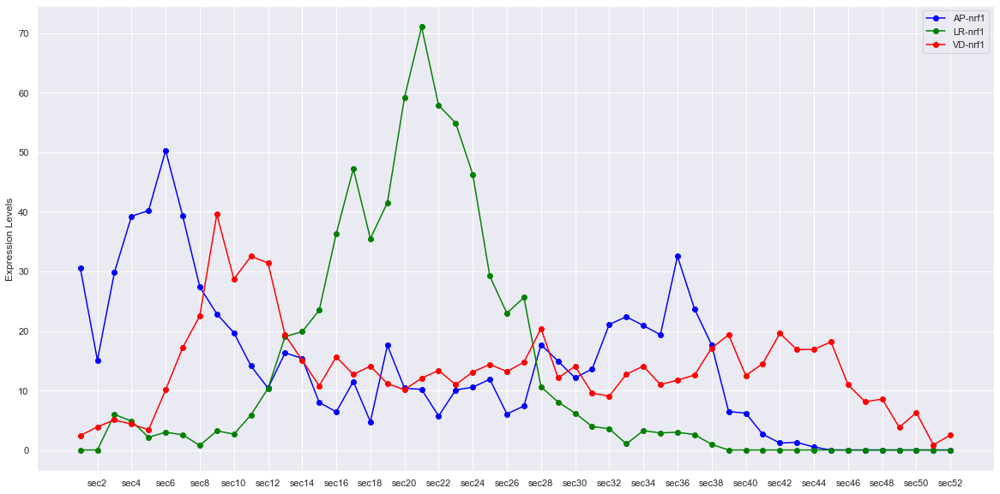

In [27]:
# Generate LinePlot to compare with SpatialDB
geneID = "nrf1"
ensemblID = gene_mapping.loc[gene_mapping['gene']==geneID]
# Need to build dataframe from AP, LR and VD dataframes to use for Multi-Line plot
lineDF = pd.DataFrame(columns=APdata.columns)
lr1 = pd.DataFrame(columns=APdata.columns)
vd1 = pd.DataFrame(columns=APdata.columns)
lensemb_value=ensemblID.index.values

# Find gene in each of the 3 DataFrames
lineDF=APdata.loc[lensemb_value,:]
lr1=LRdata.loc[lensemb_value,:]
vd1=VDdata.loc[lensemb_value,:]

# Now append results into 1 DataFrame
lineDF=lineDF.append(lr1,ignore_index=False)
lineDF=lineDF.append(vd1,ignore_index=False)

# Transpose ne DataFrame
lineDFT = lineDF.T

# Set Labels
lineDFT.columns=['AP-'+geneID,'LR-'+geneID,'VD-'+geneID]

# Set frequency of x tick marks
p=0
xticks_label = pd.DataFrame(columns=['label'])
for col_num, value in enumerate(lineDFT.index.values):
    if(col_num%2):
        xticks_label.loc[p] = [value]
        p=p+1
        
# Set Tick Labels        
label_list = [1,3,5,7,9,11,13,15,17,19,21,23,25,27,29,31,33,35,37,39,41,43,45,47,49,51]
markers=['o','d','s']
lineDFT.plot(figsize=(20,10),grid=True,xticks=label_list,color=["blue","green","red"],marker='o', ylabel="Expression Levels")
plt.show()

# To Run Later Sections Run All Above from this section
## No Go to Next Run Point 2.

## Section 2: Data Preperation for future processing


In [28]:
# Transpose Matrix for processing
APdataT=APdata.T
LRdataT=LRdata.T
VDdataT=VDdata.T

# Build list to convert Ensemble to Gene for index or column labels.
labelsArray = pd.DataFrame()

# Convert index to gene name
numCols = len(gene_mapping)

indexLabels = APdata.index.to_list()
x=0
# Loop through the data source and map to the correct gene name by the ensemble ID
for i, value in enumerate(APdata.index.values):
    esmblLabel=indexLabels[i]
    labelsArray.loc[x,'gene'] = gene_mapping.loc[esmblLabel,'gene']
    x=x+1
y_axis_labels = labelsArray['gene'].tolist()

## Write out put to file

In [ ]:
# Print output to confirm data format
print_output_to_file("transposed_output.xlsx", APdataT,"Sheet1","w")
print_output_to_file("transposed_output.xlsx", LRdataT,"Sheet2","a")
print_output_to_file("transposed_output.xlsx", VDdataT,"Sheet3","a")

## Section 3: Build Quantile map in 10ths from Source Data to see if it helps identify grouping

In [10]:
#DEFINE Quantile
import pandas as pd 
df = APdataT

quant = df.quantile([.0,.1, .2, .3, .4, .5, .6, .7, .8, .9, 1.0])
#quant

## Functions to convert Quintile Values into normalized valuses accross the Data Source

In [25]:
#Label Gene Section 1-10 based on Quintile value
def LabelFunc2(xvalue,icolumn):
    if(xvalue<=quant.iloc[0][icolumn]): retvalue = "0"
    elif(xvalue<=quant.iloc[1][icolumn]): retvalue = "10"
    elif(xvalue<=quant.iloc[2][icolumn]): retvalue = "20"
    elif(xvalue<=quant.iloc[3][icolumn]): retvalue = "30" 
    elif(xvalue<=quant.iloc[4][icolumn]): retvalue = "40"
    elif(xvalue<=quant.iloc[5][icolumn]): retvalue = "50" 
    elif(xvalue<=quant.iloc[6][icolumn]): retvalue = "60"
    elif(xvalue<=quant.iloc[7][icolumn]): retvalue = "70" 
    elif(xvalue<=quant.iloc[8][icolumn]): retvalue = "80"
    elif(xvalue<=quant.iloc[9][icolumn]): retvalue = "90" 
    else: retvalue = "100"
    return retvalue 

In [ ]:
# Process Gene Data against Quantile
import xlsxwriter
Cols = len(APdataT.columns)
Rows = len(APdataT)

df=APdataT
# Create new Excel file below here
workbook   = xlsxwriter.Workbook('APQuantiles.xlsx')
worksheet1 = workbook.add_worksheet('Sheet1')

# Add a header format.
header_format = workbook.add_format({
    'bold': True,
    'text_wrap': True,
    'valign': 'top',
    'fg_color': '#D7E4BC',
    'border': 1})

# Write the column headers with the defined format.
# but first set label for later indexing
worksheet1.write(0,0,"ENSEMBL")
for col_num, value in enumerate(APdataT.columns.values):
    worksheet1.write(0, col_num + 1, value, header_format)

# Write the row headers with the defined format.
for row_num, value in enumerate(APdataT.index):
    worksheet1.write(row_num + 1, 0, value, header_format)
# Logic

p=0
q=0

while q < Cols:
    p=0
    while p < Rows:
        z = APdataT.iloc[p][q]
        ret1 =LabelFunc2(z,q)
        # Instead of print write to excel cell 
        worksheet1.write(p+1, q+1, ret1)  
        p=p+1
    q=q+1
workbook.close()

In [ ]:
# Process Gene Data against Quantile
import xlsxwriter
Cols = len(LRdataT.columns)
Rows = len(LRdataT)

df=APdataT
# Create new Excel file below here
workbook   = xlsxwriter.Workbook('LRQuantiles.xlsx')
worksheet1 = workbook.add_worksheet('Sheet1')

# Add a header format.
header_format = workbook.add_format({
    'bold': True,
    'text_wrap': True,
    'valign': 'top',
    'fg_color': '#D7E4BC',
    'border': 1})

# Write the column headers with the defined format.
# but first set label for later indexing
worksheet1.write(0,0,"ENSEMBL")
for col_num, value in enumerate(LRdataT.columns.values):
    worksheet1.write(0, col_num + 1, value, header_format)

# Write the row headers with the defined format.
for row_num, value in enumerate(LRdataT.index):
    worksheet1.write(row_num + 1, 0, value, header_format)
# Logic

p=0
q=0

while q < Cols:
    p=0
    while p < Rows:
        z = LRdataT.iloc[p][q]
        ret1 =LabelFunc2(z,q)
        # Instead of print write to excel cell 
        worksheet1.write(p+1, q+1, ret1)  
        p=p+1
    q=q+1
workbook.close()

In [ ]:
# Process Gene Data against Quantile
import xlsxwriter
Cols = len(VDdataT.columns)
Rows = len(VDdataT)

df=APdataT
# Create new Excel file below here
workbook   = xlsxwriter.Workbook('VDQuantiles.xlsx')
worksheet1 = workbook.add_worksheet('Sheet1')

# Add a header format.
header_format = workbook.add_format({
    'bold': True,
    'text_wrap': True,
    'valign': 'top',
    'fg_color': '#D7E4BC',
    'border': 1})

# Write the column headers with the defined format.
# but first set label for later indexing
worksheet1.write(0,0,"ENSEMBL")
for col_num, value in enumerate(VDdataT.columns.values):
    worksheet1.write(0, col_num + 1, value, header_format)

# Write the row headers with the defined format.
for row_num, value in enumerate(VDdataT.index):
    worksheet1.write(row_num + 1, 0, value, header_format)
# Logic

p=0
q=0

while q < Cols:
    p=0
    while p < Rows:
        z = VDdataT.iloc[p][q]
        ret1 =LabelFunc2(z,q)
        # Instead of print write to excel cell 
        worksheet1.write(p+1, q+1, ret1)  
        p=p+1
    q=q+1
workbook.close()

## Section 4: Create Heatmaps from Quntile values above

In [10]:
# HEAT MAP based on Quantiles arranged above
# Open and Read Quantiles.xlsx
# Import external data
# convert data type

    
# import data for analysis
APqdata = pd.read_excel("APQuantiles.xlsx",sheet_name='Sheet1')
LRqdata = pd.read_excel("LRQuantiles.xlsx",sheet_name='Sheet1')
VDqdata = pd.read_excel("VDQuantiles.xlsx",sheet_name='Sheet1')

# set index to and axis to gene
APqdata.index = APqdata['ENSEMBL']
APqdata = APqdata.drop('ENSEMBL', axis=1)

LRqdata.index = LRqdata['ENSEMBL']
LRqdata = LRqdata.drop('ENSEMBL', axis=1)

VDqdata.index = VDqdata['ENSEMBL']
VDqdata = VDqdata.drop('ENSEMBL', axis=1)

#Transpose qdata
APqdataT = APqdata.T
LRqdataT = LRqdata.T
VDqdataT = VDqdata.T


## Now Generate a Heatmap from the percentages.

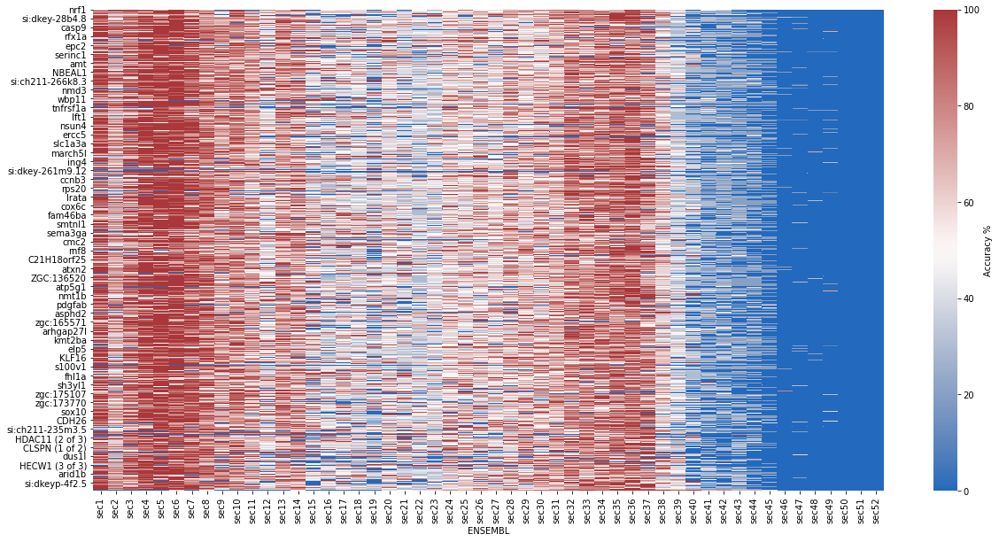

In [11]:
# Build Heatmap
plt.figure(figsize=(20,10))
labelsArray = pd.DataFrame()

# Make a copy of the source data so the index can be mapped to gene name
pltdf = APqdata
pltdfT = pltdf.T

# Convert index to gene name
numCols = len(gene_mapping)
x=0

pltdfT.index=y_axis_labels
#display(y_axis_labels)
#plot heatmap
p1 = sns.heatmap(pltdfT,cbar_kws={'label': 'Accuracy %'},cmap="vlag")

# Hide dendrogram
#p1.ax_row_dendrogram.set_visible(False)

In [30]:
labelsArray = pd.DataFrame()

# Convert index to gene name
numCols = len(gene_mapping)

indexLabels = APqdataT.index.to_list()
x=0
# Loop through the data source and map to the correct gene name by the ensemble ID
for i, value in enumerate(APqdataT.index.values):
    esmblLabel=indexLabels[i]
    labelsArray.loc[x,'gene'] = gene_mapping.loc[esmblLabel,'gene']
    x=x+1
y_axis_labels = labelsArray['gene'].tolist()
APqdataT.index=y_axis_labels

indexLabels = LRqdataT.index.to_list()
x=0
# Loop through the data source and map to the correct gene name by the ensemble ID
for i, value in enumerate(LRqdataT.index.values):
    esmblLabel=indexLabels[i]
    labelsArray.loc[x,'gene'] = gene_mapping.loc[esmblLabel,'gene']
    x=x+1
y_axis_labels = labelsArray['gene'].tolist()
LRqdataT.index=y_axis_labels

indexLabels = VDqdataT.index.to_list()
x=0
# Loop through the data source and map to the correct gene name by the ensemble ID
for i, value in enumerate(VDqdataT.index.values):
    esmblLabel=indexLabels[i]
    labelsArray.loc[x,'gene'] = gene_mapping.loc[esmblLabel,'gene']
    x=x+1
y_axis_labels = labelsArray['gene'].tolist()
VDqdataT.index=y_axis_labels

## Now Generate a Heatmap from a Subset of sections.

In [ ]:
# Generate Heatmap but focused on top 20% of releations
plt.figure(figsize=(10, 6))

p1 = sns.heatmap(pltdfT, vmin=90, vmax=100,cbar_kws={'label': 'Accuracy %'},cmap="vlag")
# Hide dendrogram
#p1.ax_row_dendrogram.set_visible(False)


In [ ]:
# Generate Heatmap but focused on top 20% of releations
plt.figure(figsize=(10, 6))

p1 = sns.heatmap(APqdataT, vmin=90, vmax=100,cbar_kws={'label': 'Accuracy %'},cmap="vlag")

In [ ]:
# Generate Heatmap but focused on top 20% of releations
plt.figure(figsize=(10, 6))

p1 = sns.heatmap(LRqdataT, vmin=90, vmax=100,cbar_kws={'label': 'Accuracy %'},cmap="vlag")

In [ ]:
# Generate Heatmap but focused on top 20% of releations
plt.figure(figsize=(10, 6))

p1 = sns.heatmap(VDqdataT, vmin=90, vmax=100,cbar_kws={'label': 'Accuracy %'},cmap="vlag")

In [ ]:
# Query above results
# Select Gene, Begining Secion Range, Ending Section Range
geneID = "zgc:77849"
beginingRange = "4,5,6"
endingRange = "35,36,37"

pltdfT.columns=section_map[0:52]

# See if I can find if the gene has the value 100 from sections 3-5
p2 = pltdfT.loc[(pltdfT.index==geneID) & (pltdfT.iloc[:,3:5]==100).all(axis=1)]
display(p2)
# Query to see if gene that no sections beyond sec5 contains 0
p2 = pltdfT.loc[(pltdfT.index==geneID) & (pltdfT.iloc[:,3:5]==100).all(axis=1) & (pltdfT.iloc[:,6:]!=0).all(axis=1)]
display(p2)
# Query to see if the gene has no sections beyond sec5 is = 100 
p2 = pltdfT.loc[(pltdfT.index==geneID) & (pltdfT.iloc[:,3:5]==100).all(axis=1) & (pltdfT.iloc[:,6:]==100).all(axis=1)]
display(p2)



In [ ]:
# Expand the query function from above to loop through every gene
# Create a new data frame to hold the query results for visualization
output1=pd.DataFrame()
output2=output1

firstrow = 0
# Loop through each gene and compare against the query criteria
for col_num, value in enumerate(pltdfT.index.values):
    output1=pltdfT.loc[(pltdfT.index==value) & (pltdfT.iloc[:,0]!=100) & (pltdfT.iloc[:,1]!=100) & (pltdfT.iloc[:,2]!=100) & (pltdfT.iloc[:,3]==100) & (pltdfT.iloc[:,4]==100) & (pltdfT.iloc[:,5]==100) & (pltdfT.iloc[:,6]!=100)]
    if (len(output1) > 0):
        if (firstrow == 0):
            output2 = output1
            firstrow = 1
        else:
            output2 = output2.append(output1)
        
#output reults    
#output2


In [ ]:
# Define the Pearson Correlation
# pearcorr = dataT.corr('pearson')
from scipy.cluster.hierarchy import cut_tree
pearcorr = APdataT.corr()

# Build a emptyp dataframe for holding the Gene information being queried
geneGroup = pd.DataFrame()

p=0
q=0
indexLabels = APdata.index.to_list()

#Step through the source data and develop Pearson and Euclidean distance information
for gene_id, value in enumerate(APdataT.columns.values):
    average_gene = APdata.mean()
    gene = APdata.loc[[value],:].values.flatten()
    
    # Build Pearson correlation
    pearson = stats.pearsonr(average_gene , gene)
    esmblLabel=indexLabels[gene_id]
    geneGroup.loc[value,"name"]=gene_mapping.loc[esmblLabel,'gene']
    geneGroup.loc[value,"pearson"] = pearson[0]
    geneGroup.loc[value,"pearson_pvalue"] = pearson[1]
    
    # Build Euclidean correlation
    euclidean_dir = euclidean_distances(np.array(average_gene).reshape(1, -1) , np.array(gene).reshape(1, -1))
    geneGroup.loc[value, "euclidean_dir"] = euclidean_dir[0][0]    

# Print output to confirm data format
# print_output_to_file("distance_output.xlsx", geneGroup,"Sheet1","w")
print_output_to_csv("distance_output.csv", geneGroup)
print(geneGroup.head())


## Section 3: Evaluate Data

In [111]:
# Review the current Dataframe to see if it is in the correct structure for  
APdataT.head()

ENSEMBL,ENSDARG00000000018,ENSDARG00000000019,ENSDARG00000000068,ENSDARG00000000069,ENSDARG00000000086,ENSDARG00000000102,ENSDARG00000000103,ENSDARG00000000142,ENSDARG00000000175,ENSDARG00000000183,ENSDARG00000000212,ENSDARG00000000229,ENSDARG00000000241,ENSDARG00000000324,ENSDARG00000000370,ENSDARG00000000380,ENSDARG00000000394,ENSDARG00000000442,ENSDARG00000000476,ENSDARG00000000489,ENSDARG00000000503,ENSDARG00000000529,ENSDARG00000000540,ENSDARG00000000542,ENSDARG00000000551,ENSDARG00000000563,ENSDARG00000000567,ENSDARG00000000568,ENSDARG00000000588,ENSDARG00000000631,ENSDARG00000000651,ENSDARG00000000666,ENSDARG00000000690,ENSDARG00000000729,ENSDARG00000000730,ENSDARG00000000747,ENSDARG00000000760,ENSDARG00000000767,ENSDARG00000000779,ENSDARG00000000804,ENSDARG00000000830,ENSDARG00000000853,ENSDARG00000000857,ENSDARG00000000861,ENSDARG00000000887,ENSDARG00000000906,ENSDARG00000000935,ENSDARG00000000943,ENSDARG00000000966,ENSDARG00000000972,ENSDARG00000001014,ENSDARG00000001057,ENSDARG00000001129,ENSDARG00000001162,ENSDARG00000001210,ENSDARG00000001220,ENSDARG00000001241,ENSDARG00000001244,ENSDARG00000001249,ENSDARG00000001285,ENSDARG00000001313,ENSDARG00000001414,ENSDARG00000001431,ENSDARG00000001447,ENSDARG00000001452,ENSDARG00000001470,ENSDARG00000001549,ENSDARG00000001557,ENSDARG00000001558,ENSDARG00000001578,ENSDARG00000001621,ENSDARG00000001634,ENSDARG00000001637,ENSDARG00000001676,ENSDARG00000001721,ENSDARG00000001729,ENSDARG00000001733,ENSDARG00000001734,ENSDARG00000001754,ENSDARG00000001767,ENSDARG00000001769,ENSDARG00000001776,ENSDARG00000001777,ENSDARG00000001781,ENSDARG00000001782,ENSDARG00000001784,ENSDARG00000001785,ENSDARG00000001788,ENSDARG00000001807,ENSDARG00000001829,ENSDARG00000001857,ENSDARG00000001859,ENSDARG00000001873,ENSDARG00000001879,ENSDARG00000001880,ENSDARG00000001888,ENSDARG00000001889,ENSDARG00000001890,ENSDARG00000001897,ENSDARG00000001898,ENSDARG00000001910,ENSDARG00000001929,ENSDARG00000001930,ENSDARG00000001939,ENSDARG00000001940,ENSDARG00000001950,ENSDARG00000001968,ENSDARG00000001976,ENSDARG00000001994,ENSDARG00000002006,ENSDARG00000002013,ENSDARG00000002016,ENSDARG00000002020,ENSDARG00000002021,ENSDARG00000002031,ENSDARG00000002060,ENSDARG00000002071,ENSDARG00000002077,ENSDARG00000002082,ENSDARG00000002084,ENSDARG00000002127,ENSDARG00000002128,ENSDARG00000002131,ENSDARG00000002148,ENSDARG00000002165,ENSDARG00000002167,ENSDARG00000002168,ENSDARG00000002172,ENSDARG00000002174,ENSDARG00000002184,ENSDARG00000002190,ENSDARG00000002196,ENSDARG00000002197,ENSDARG00000002210,ENSDARG00000002213,ENSDARG00000002215,ENSDARG00000002216,ENSDARG00000002217,ENSDARG00000002220,ENSDARG00000002230,ENSDARG00000002235,ENSDARG00000002240,ENSDARG00000002264,ENSDARG00000002267,ENSDARG00000002271,ENSDARG00000002285,ENSDARG00000002299,ENSDARG00000002303,ENSDARG00000002304,ENSDARG00000002305,ENSDARG00000002332,ENSDARG00000002333,ENSDARG00000002336,ENSDARG00000002339,ENSDARG00000002344,ENSDARG00000002347,ENSDARG00000002355,ENSDARG00000002362,ENSDARG00000002365,ENSDARG00000002369,ENSDARG00000002377,ENSDARG00000002385,ENSDARG00000002396,ENSDARG00000002400,ENSDARG00000002401,ENSDARG00000002402,ENSDARG00000002403,ENSDARG00000002412,ENSDARG00000002445,ENSDARG00000002463,ENSDARG00000002467,ENSDARG00000002479,ENSDARG00000002483,ENSDARG00000002487,ENSDARG00000002494,ENSDARG00000002506,ENSDARG00000002507,ENSDARG00000002510,ENSDARG00000002523,ENSDARG00000002533,ENSDARG00000002536,ENSDARG00000002538,ENSDARG00000002549,ENSDARG00000002552,ENSDARG00000002571,ENSDARG00000002587,ENSDARG00000002591,ENSDARG00000002601,ENSDARG00000002609,ENSDARG00000002613,ENSDARG00000002614,ENSDARG00000002632,ENSDARG00000002634,ENSDARG00000002642,ENSDARG00000002644,ENSDARG00000002656,ENSDARG00000002659,ENSDARG00000002663,ENSDARG00000002670,ENSDARG00000002682,ENSDARG00000002690,ENSDARG00000002702,ENSDARG00000002707,ENSDARG00000002710,ENSDARG00000002720,ENSDARG00000002731,ENSDARG00000002745,ENSDARG00000002748,ENSDARG00000002754,ENSDARG00000002758,EN

In [ ]:
# MAX GENE
max(APdataT)

In [ ]:
# MIN GENE
min(APdataT)

In [112]:
APdata['sec1'].mean()

46.244498264033254

# Ability to select a gene then review the pearson correlation distance and list genes with in range

In [31]:
# First need to put Pearson Correlation into a DataFrame for processing
from scipy.spatial.distance import squareform
#pdata=pd.DataFrame(squareform(pdist(data,'correlation')),columns=data.index,index=data.index)
APdataT = APdata.T
LRdataT = LRdata.T
VDdataT = VDdata.T

APpdata=APdataT.corr()
APpdata.index=y_axis_labels
APpdata.columns=y_axis_labels

LRpdata=LRdataT.corr()
LRpdata.index=y_axis_labels
LRpdata.columns=y_axis_labels

VDpdata=VDdataT.corr()
VDpdata.index=y_axis_labels
VDpdata.columns=y_axis_labels
# Print output to confirm data format
# print_output_to_file("pdata_output.xlsx", pdata,"Sheet1","w")
# print_output_to_csv("pdata_output.csv",pdata)

In [36]:
display(APpdata.head(n=10))

,nrf1,ube2h,slc9a3r1,dap,itsn1,musk,myh10,C10H5orf28,hoxb2a,ptpn4b,zgc:92061,usp49,slc40a1,DCAF8,triob,pde6a,matr3l1.1,slc39a13,pms1,upf3b,stx1b,ofd1,asnsd1,gtf2e1,slc1a4,ttnb,ZNF281 (1 of 2),ell,grasp,ptpn4a,osgepl1,creg2,sypl2b,daxx,slc6a13,lcmt2,znf511,spi1b,sly1,rassf6,telo2,dstyk,mapk14a,scrib,GTSF1,skap2,unk,dzip1,ncor2,pcxa,myh9b,bysl,dicer1,matr3l1.1,arl14ep,mycbp2,puf60b,srrm1,pcgf1,rbm14b,g2e3,mctp2a,actn3b,mier1b,adam8a,mhc1zea,sp3a,tomm34,kifc1,echs1,nfyal,kirrela,CU695232.1,gpm6bb,oc90,strn3,gulp1a,fkbp8,noc2l,slc29a2,ptpra,stim2b,nup155,tspan11,prkacba,hoxa5a,irx2a,atp5o,tnfrsf21,zgc:112982,aff4,dbx1b,phgdh,nav2b,stx3a,ppm1ba,tuba1a,stt3b,man2b1,manea,rorab,pink1,klhl15,b3gat3,dnajc1,ak1,dock5,si:ch211-13k12.1,stxbp1a,rxrbb,grb10a,ppil2,rictorb,pygb,tox4,brf2,adss,mnat1,ck2a1,lamb2,stam,cwf19l1,celf2,DVL3 (1 of 2),psme1,cacnb1,tra2b,aplnra,itfg2,igbp1,chmp2bb,bach1,pygl,stk25a,invs,rtca,tbx3a,scocb,C5H9orf78,sypb,mmp14a,psmb6,mrpl41,dcaf13,zfand5b,mcoln1a,arsh,xpot,gins2,me3,frmd6,fam102bb,dlc,ccdc101,tubb4b,cyp11a1,shpk,ubald1a,cers5,UBC,mief2,atm,cry-dash,nap1l1,gale,ercc3,nusap1,elovl1a,prdm1a,CU074314.1,rdh14b,ercc6l,WNT7A (1 of 2),noc3l,itgb6,C7H16orf87,itga10,dmbx1b,hsdl2,adora2b,tm9sf4,smu1a,eif3eb,mapkapk2a,tmod2,dpysl3,ruvbl1,irx7,RNF145 (1 of 2),rpa3,pip5k1aa,anxa11b,b4galt1,sh3gl1b,rgs5a,stxbp5a,mapre1b,optn,ATG14,tbcela,rabif,surf4,her11,ncl,utp15,sdc2,tdh,sema6d,pdcd2l,dedd1,pdx1,gro2,ap2m1a,atp1a1a.1,arcn1a,meis3,cog8,cep57l1,trmt2a,si:dkey-28b4.8,zgc:113210,reps1,CCDC132 (1 of 2),aven,CR318593.1,tjp3,adipor1a,sec31b,gbx2,meis4.1a,abcd3b,ppp6c,smo,pdap1b,a1cf,ss18,phc1,vps54,cyp2aa4,cep135,itpkca,prkcea,eef2b,zgc:55512,hdac8,scnm1,eif4a1b,hspa9,CABZ01111496.1,sorbs2a,hccs,fgfr1op,cd276,gorasp1,btbd7,si:ch73-111m19.2,mybphb,stambpl1,ubxn6,oclnb,kdm5bb,zgc:101130,rcan1a,zgc:123105,apip,dachc,pxmp2,skp1,cpsf5,nr2f6b,mlst8,magi1b,psmd1,rassf7b,ngly1,mterfd1,pomk,naa15a,anxa2a,urb2,nup88,gbp3,zbtb22b,zgc:101559,pop4,clcn3,dhps,pik3ip1,zfand2a,wdr12,sox9a,stx16,emc2,pank2,fam91a1,dcp1a,commd2,gng12a,PAOX,cwc25,asb8,akap17a,snx7,rbpja,fgf8a,foxa2,igf2bp2a,hnrpdl,dhrs7,neurod4,slc25a42,ppp1caa,nup93,madd,mrpl3,anks1b,thrap3b,impa1,aprt,tbc1d14,psma5,mak16,tcea1,dohh,hsp90b1,dctn5,CCDC34,pla2g7,surf1,rpl3,nr2f6a,arih1,clock3,atp6v1e1a,tfg,tmem59l,cryl1,runx1t1,eif5,HECTD4 (1 of 3),obsl1a,hars,vdac3,atp7a,cldng,prnprs3,polb,pfas,lats1,tspan2,cnpy1,tada2b,pip4k2aa,ctnnd2b,efnb2b,dennd5b,IDH2,plxnb2a,srp54,prkag1,snapc1b,galnt2,stom,tmem63ba,usb1,chm,mrpl21,acsl1b,cbx3a,pard6b,tm9sf2,decr1,ccdc102a,zdhhc23b,med13b,setb,cldn12,cndp2,pkma,nxnl2,rpa1,mtfr1l,rrs1,pfn2,traf4a,ENSDARG00000003969,isl2a,chordc1a,spoplb,LTN1,spag1a,CHST13,isl1,arhgdig,cog2,phf6,marcksa,uhrf1bp1l,bhlhe40,bach2b,acsl4a,acsbg2,tie1,tti1,mvk,rttn,usp19,zgc:92630,rab23,orai1b,reep3b,ik,zgc:110366,stmn1a,rabac1,copa,cnot1,ulk4,nf1b,cbx1a,tnfsf10l,ccdc106a,rnd1l,dlb,slit2,dhfr,wnt11,tmed9,zgc:109986,atl3,zgc:112496,seh1l,ambp,irf2bpl,klhl18,fam8a1,ldlrap1a,cbwd,casp9,srsf11,nelfe,lhfp,fmnl3,ppp1r13ba,yrk,hdr,b3gnt5b,elovl6,spra,tcf7l2,dpy30,btk,fam92a1,tardbpl,desi2,prkcsh,pcyt1ab,tspan33,rcor3,ppat,C2H1orf35,pin4,kmt2a,ptgs2a,gtf3c2,plk4,sel1l,KAT5 (1 of 2),sox4a,mtmr2,gpm6ab,egln1,osbp,epha7,ccdc9,spice1,zgc:101810,hspa5,ptk2.1,dnajb6a,acaa1,nabp1a,six4a,eefsec,rxrgb,irf2bp2a,syf2,mad2l1,tcf12,ddr2l,trappc11,cmss1,tfe3a,hnrnpub,lmbr1l,zgc:100868,hspa4a,ybx1,ankrd10b,wdr36,fgfr3,cops2,b4galt4,grwd1,flot2a,dnajc5ab,rassf1,foxp1a,hinfp,esrrga,fam63a,psen1,spata6l,TMC6 (1 of 2),aga,pex19,lonp2,stip1,cat,pcif1,immp2l,slbp,lmo7a,skp2,mtdhb,bccip,zmat2,uvssa,elovl5,brf1b,TSPY2,fkbp9,tshz1,trip4,ispd,gstp1,rab20,dimt1l,ncapd2,eif4e3,ggctb,PRC1 (1 of 3),limk2,oclna,cdh17,calub,mfn1b,atp2a2b,rnaseh2b,psmd11b,tbx20,aspa,CYTH3 (1 of 3),tpm3,dynll2b,zgc:101040,sp4,ahcy,coro2a,wrnip1,ssr2,ccdc85ca,srcap,asb3,rpe,kdelr2a,ergic1,rad52,fbxl15,celf1,stam2,nipsnap1,tln1,dip2ba,larp6,sucla2,mcamb,tubgcp4,prdm9,trim3b,map3k5,pgam1a,wdfy1,ckap5,mtfmt,gdi2,foxp2,t

/Users/richardmilligan/opt/anaconda3/lib/python3.8/site-packages/seaborn/matrix.py:659: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


ValueError: The condensed distance matrix must contain only finite values.

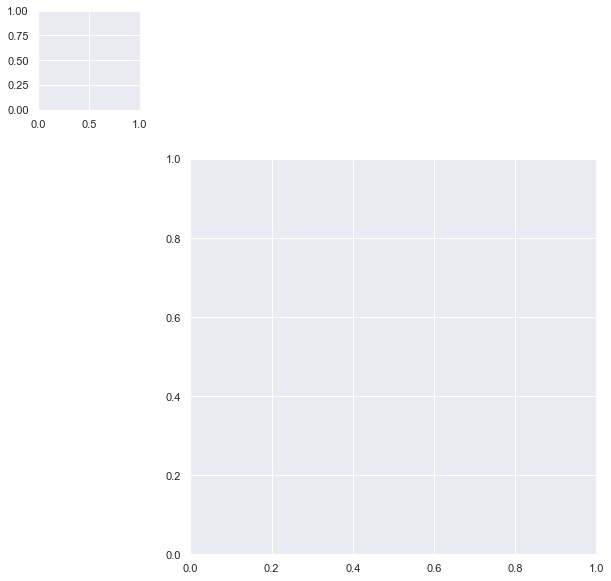

In [39]:
#Generate Heatmap with Dendogram
sns.set_theme()

# Draw the full plot
g = sns.clustermap(APdataT.corr(),cmap="vlag")

g.ax_row_dendrogram.remove()

In [ ]:
# Filter out everything below 0.9 so a new DataFrame can be developed to help identified groups 
#APfltpdata = APpdata[(APpdata >= .9) & (APpdata !=1.00)]
#LRfltpdata = LRpdata[(LRpdata >= .9) & (LRpdata !=1.00)]
#VDfltpdata = VDpdata[(VDpdata >= .9) & (VDpdata !=1.00)]
# Change so original gene is captured in the filtered list 31/3/2021
APfltpdata = APpdata[(APpdata >= .9) & (APpdata <=1.00)]
LRfltpdata = LRpdata[(LRpdata >= .9) & (LRpdata <=1.00)]
VDfltpdata = VDpdata[(VDpdata >= .9) & (VDpdata <=1.00)]
# print_output_to_file("filtered_output.xlsx", filteredpdata,"Sheet1","w")
APfltpdata = APfltpdata.fillna(0)
LRfltpdata = LRfltpdata.fillna(0)
VDfltpdata = VDfltpdata.fillna(0)
# print_output_to_csv("filtered_output.csv",filteredpdata)

## Attempted to 3d Scatter Plot on Correctalion results

In [10]:
# Open and Read Quantiles.xlsx
import pandas as pd

APqdata = pd.read_excel("transposed_output.xlsx",sheet_name='Sheet1')
LRqdata = pd.read_excel("transposed_output.xlsx",sheet_name='Sheet2')
VDqdata = pd.read_excel("transposed_output.xlsx",sheet_name='Sheet3')
Distdata = pd.read_excel("distance_output.xlsx",sheet_name='Sheet1')

# set index to and axis to gene
APqdata.rename(columns={APqdata.columns[0]:'Section'},inplace=True)
APqdata.index = APqdata['Section']
APqdata = APqdata.drop('Section', axis=1)

LRqdata.rename(columns={LRqdata.columns[0]:'Section'},inplace=True)
LRqdata.index = LRqdata['Section']
LRqdata = LRqdata.drop('Section', axis=1)

VDqdata.rename(columns={VDqdata.columns[0]:'Section'},inplace=True)
VDqdata.index = VDqdata['Section']
VDqdata = VDqdata.drop('Section', axis=1)

#Transpose qdata
APqdataT = APqdata.T
LRqdataT = LRqdata.T
VDqdataT = VDqdata.T

<Figure size 1440x864 with 0 Axes>

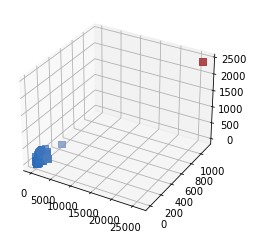

In [18]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import pandas as pd
import numpy as np

# Remake PD
#ThreeDplt = pd.read_csv('3dtest.csv')

ThreeDplt = pd.DataFrame(columns=["AP","LR","VD","Cluster"])
ThreeDplt['AP'] = APqdataT['sec2'].to_list()
ThreeDplt['LR'] = LRqdataT['sec2'].to_list()
ThreeDplt['VD'] = VDqdataT['sec2'].to_list()
ThreeDplt['Cluster'] = Distdata['euclidean_dir'].to_list()
plt.figure(figsize=(20, 12))

df = ThreeDplt

fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
x = np.array(df['AP'])
y = np.array(df['LR'])
z = np.array(df['VD'])

ax.scatter(x,y,z, marker="s", c=df["Cluster"], s=40, cmap="vlag")

plt.show()

## Query the Pearson Correlation by gene to find releationships above specified value
## Specify Gene and Range

# Read in the outputs for AP, LR and VD correlation groupings into 3 DataFrames for sorting and filtering



In [ ]:
# Organize new workbook listing Gene, Associated Genes, Pearson Correclation value for those higher than .9
# Generate for Left Right slicing
p = 1
z = 0
row_num = 0
col_num = 0

df=LRfltpdata
# Create new Excel file below here
workbook   = xlsxwriter.Workbook('PearCorr-9 LR.xlsx')
worksheet1 = workbook.add_worksheet('LR')

# Add a header format.
header_format = workbook.add_format({
    'bold': True,
    'text_wrap': True,
    'valign': 'top',
    'fg_color': '#D7E4BC',
    'border': 1})

# Write the column headers with the defined format.
# but first set label for later indexing
# ['gene','associated_gene','pear_value','column_num','row_num']
worksheet1.write(0,0,"gene")
worksheet1.write(0,1,"associated_gene")
worksheet1.write(0,2,"ensembleID")
worksheet1.write(0,3,"pear_value")
worksheet1.write(0,4,"col_num")
worksheet1.write(0,5,"row_num")
           
# Logic
# Loop through the data source and map to the correct gene name by the ensemble ID
for col_num, value in enumerate(LRfltpdata.columns.values):
    for row_num, value1 in enumerate(LRfltpdata.columns.values):
        z = LRfltpdata.iloc[row_num][col_num]
        if (z >= 0.9):
            esmblLabel=value1
            #geneGrouping.loc[p]=[value,value1,z,col_num,row_num]
            #print([p, z, value, value1, col_num, row_num])
            worksheet1.write(p, 0, value) 
            worksheet1.write(p, 1, value1)
            worksheet1.write(p, 2, gene_mapping.index[row_num])
            worksheet1.write(p, 3, z)
            worksheet1.write(p, 4, col_num)
            worksheet1.write(p, 5, row_num)
            p=p+1
    
workbook.close()

In [ ]:
# Organize new workbook listing Gene, Associated Genes, Pearson Correclation value for those higher than .9
# Generate for Vertical Down slicing
p = 1
z = 0
row_num = 0
col_num = 0

df=LRfltpdata
# Create new Excel file below here
workbook   = xlsxwriter.Workbook('PearCorr-9 VD.xlsx')
worksheet1 = workbook.add_worksheet('VD')

# Add a header format.
header_format = workbook.add_format({
    'bold': True,
    'text_wrap': True,
    'valign': 'top',
    'fg_color': '#D7E4BC',
    'border': 1})

# Write the column headers with the defined format.
# but first set label for later indexing
# ['gene','associated_gene','pear_value','column_num','row_num']
worksheet1.write(0,0,"gene")
worksheet1.write(0,1,"associated_gene")
worksheet1.write(0,2,"ensembleID")
worksheet1.write(0,3,"pear_value")
worksheet1.write(0,4,"col_num")
worksheet1.write(0,5,"row_num")
           
# Logic
# Loop through the data source and map to the correct gene name by the ensemble ID
for col_num, value in enumerate(VDfltpdata.columns.values):
    for row_num, value1 in enumerate(VDfltpdata.columns.values):
        z = VDfltpdata.iloc[row_num][col_num]
        if (z >= 0.9):
            esmblLabel=value1
            #geneGrouping.loc[p]=[value,value1,z,col_num,row_num]
            #print([p, z, value, value1, col_num, row_num])
            worksheet1.write(p, 0, value) 
            worksheet1.write(p, 1, value1)
            worksheet1.write(p, 2, gene_mapping.index[row_num])
            worksheet1.write(p, 3, z)
            worksheet1.write(p, 4, col_num)
            worksheet1.write(p, 5, row_num)
            p=p+1
    
workbook.close()

In [ ]:
# Organize new workbook listing Gene, Associated Genes, Pearson Correclation value for those higher than .9
# Generate for Anterior Posterior slicing
p = 1
z = 0
row_num = 0
col_num = 0

df=LRfltpdata
# Create new Excel file below here
workbook   = xlsxwriter.Workbook('PearCorr-9 AP.xlsx')
worksheet1 = workbook.add_worksheet('AP')

# Add a header format.
header_format = workbook.add_format({
    'bold': True,
    'text_wrap': True,
    'valign': 'top',
    'fg_color': '#D7E4BC',
    'border': 1})

# Write the column headers with the defined format.
# but first set label for later indexing
# ['gene','associated_gene','pear_value','column_num','row_num']
worksheet1.write(0,0,"gene")
worksheet1.write(0,1,"associated_gene")
worksheet1.write(0,2,"ensembleID")
worksheet1.write(0,3,"pear_value")
worksheet1.write(0,4,"col_num")
worksheet1.write(0,5,"row_num")
           
# Logic
# Loop through the data source and map to the correct gene name by the ensemble ID
for col_num, value in enumerate(APfltpdata.columns.values):
    for row_num, value1 in enumerate(APfltpdata.columns.values):
        z = APfltpdata.iloc[row_num][col_num]
        if (z >= 0.9):
            esmblLabel=value1
            #geneGrouping.loc[p]=[value,value1,z,col_num,row_num]
            #print([p, z, value, value1, col_num, row_num])
            worksheet1.write(p, 0, value) 
            worksheet1.write(p, 1, value1)
            worksheet1.write(p, 2, gene_mapping.index[row_num])
            worksheet1.write(p, 3, z)
            worksheet1.write(p, 4, col_num)
            worksheet1.write(p, 5, row_num)
            p=p+1
    
workbook.close()

## Process the above excel files.  Sort by Gene, then pearson corrolation value
## This allows to see the top associated genes to the selected gene.

In [36]:
# Start by reading in results for sections above.
APlistdata = pd.read_excel("PearCorr-9 AP.xlsx",sheet_name='AP')
LRlistqdata = pd.read_excel("PearCorr-9 LR.xlsx",sheet_name='LR')
VDlistqdata = pd.read_excel("PearCorr-9 VD.xlsx",sheet_name='VD')

In [37]:
# Now sort by gene then person value.
# This will allow the selection of a gene, then show associated genes by closest distance
APlistdata = APlistdata.sort_values(by=['gene','pear_value'],ascending=[True,False])
LRlistdata = LRlistqdata.sort_values(by=['gene','pear_value'],ascending=[True,False])
VDlistdata = VDlistqdata.sort_values(by=['gene','pear_value'],ascending=[True,False])
display(APlistdata.head(n=11))

,gene,associated_gene,ensembleID,pear_value,col_num,row_num
628824,ACBD3,ACBD3,ENSDARG00000024602,1.000000,3144,3144
1008246,ACVR2B (1 of 2),ACVR2B (1 of 2),ENSDARG00000041516,1.000000,5299,5299
1008335,ACVR2B (1 of 2),smarca5,ENSDARG00000052348,0.969639,5299,6256
1007957,ACVR2B (1 of 2),parp1,ENSDARG00000019529,0.968778,5299,2580
1008074,ACVR2B (1 of 2),ssbp3b,ENSDARG00000030155,0.967730,5299,3664
1008369,ACVR2B (1 of 2),arl6ip1,ENSDARG00000054578,0.964608,5299,6574
1008472,ACVR2B (1 of 2),jam3b,ENSDARG00000061794,0.964094,5299,7881
1007799,ACVR2B (1 of 2),prmt1,ENSDARG00000010246,0.963088,5299,1233
1008345,ACVR2B (1 of 2),khdrbs1a,ENSDARG00000052856,0.962922,5299,6345
1008575,ACVR2B (1 of 2),wu:fb18c02,ENSDARG00000076532,0.962372,5299,9648


In [15]:

newdata = APlistdata.query('gene=="aaas"')
display(newdata.head(n=11))

,gene,associated_gene,ensembleID,pear_value,col_num,row_num
530712,aaas,aaas,ENSDARG00000019547,1.000000,2583,2583
531125,aaas,eif4g2b,ENSDARG00000057167,0.966867,2583,7007
530799,aaas,vangl2,ENSDARG00000027397,0.965290,2583,3393
530842,aaas,zgc:92066,ENSDARG00000031776,0.963024,2583,3847
530950,aaas,drg1,ENSDARG00000039345,0.962145,2583,4936
531337,aaas,si:ch211-209n20.57,ENSDARG00000086791,0.961493,2583,10618
531142,aaas,lsm7,ENSDARG00000058328,0.960625,2583,7205
531347,aaas,CABZ01059309.1,ENSDARG00000087837,0.959372,2583,10759
530689,aaas,txnrd1,ENSDARG00000017864,0.959216,2583,2315
531071,aaas,khdrbs1a,ENSDARG00000052856,0.959172,2583,6345


## Now develop a method to loop through the genes displayed above and use build a CSV file that can be processed by Metascape.

In [ ]:
# Define a Dataframe to hold the filtered results for AP, LR, VD
# Build excel file in a multi gene list for Metascape for a 3D look at the Genes
# As LR filtered list is the smallest of the 3 sets, it will be the search index for all 3
# Process Gene Data against Quantile
import xlsxwriter

LRGeneList = LRlistdata['gene'].unique()

# Loop through the LRGeneList and search each list to see if the Gene appears in each. If they do
# build into a file for Metascape
i=0
while i < len(LRGeneList):
    geneID=LRGeneList[i]
    LRdata = LRlistdata.query('gene==@geneID')
    APdata = APlistdata.query('gene==@geneID')
    VDdata = VDlistdata.query('gene==@geneID')
# Now Grap the 11 closest genes based on Perr Correlation
    LRdata = LRdata[:50]
    APdata = APdata[:50]
    VDdata = VDdata[:50]
    geneComp = pd.DataFrame()
# If all 3 list have genes then build into file
    if((len(LRdata)>=10)and(len(APdata)>=10))and(len(VDdata)>=10):
        # Create new Excel file below here
        filename1 = "./ToProcess/"+geneID+".xlsx"
        workbook   = xlsxwriter.Workbook(filename1)
        worksheet1 = workbook.add_worksheet('Sheet1')
# Write the column headers set label for later indexing
        worksheet1.write(0,0,"LR")
        worksheet1.write(0,1,"AP")
        worksheet1.write(0,2,"VD")
# Write the row headers with the defined format and write values to the excel file.
        LRlist=LRdata['ensembleID']
        LRlist=LRlist.tolist()
        Rows = len(LRlist)
        p=0
        while p < Rows:
            ret1 = LRlist[p]
            # Instead of print write to excel cell 
            worksheet1.write(p+1, 0, ret1)  
            p=p+1

        APlist=APdata['ensembleID']
        APlist=APlist.tolist()
        Rows = len(APlist)
        p=0
        while p < Rows:
            ret1 = APlist[p]
            # Instead of print write to excel cell 
            worksheet1.write(p+1, 1, ret1)  
            p=p+1

        VDlist=VDdata['ensembleID']
        VDlist=VDlist.tolist()
        Rows = len(VDlist)
        p=0
        while p < Rows:
            ret1 = VDlist[p]
            # Instead of print write to excel cell 
            worksheet1.write(p+1, 2, ret1)  
            p=p+1
        workbook.close()
    i=i+1

## Smaller selection of genes based on their pearson corrolation distance for Heatmap
## Identify 10-15 Genes that group in the peak areas and plot them in a Heatmap

<AxesSubplot:>

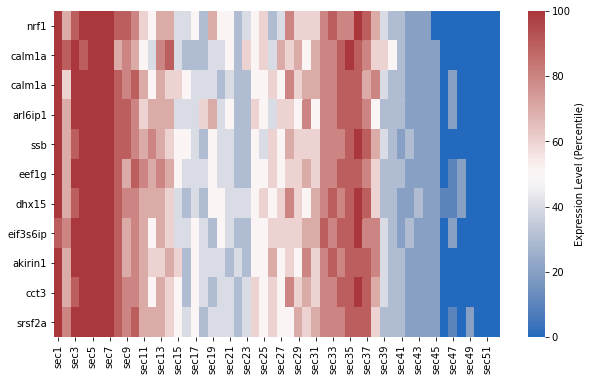

In [12]:
# Generate New DataFrame from list of genes
labelsArray = pd.DataFrame()
geneList1 = ['nrf1','calm1a','arl6ip1','ssb','eef1g','dhx15','eif3s6ip','akirin1','cct3','srsf2a']

# Create new DataFrame to hold values
genePD1 = pd.DataFrame(columns=APdata.columns)
lineDF = pd.DataFrame(columns=APdata.columns)
firstline = True

# Need to build dataframe from AP for heatmaps
for geneID in geneList1:
    ensemblID = gene_mapping.loc[gene_mapping['gene']==geneID]
    lensemb_value=ensemblID.index.values
    lineDF=APdata.loc[lensemb_value,:]
    if(firstline):
        genePD1 = lineDF
        firstline = False
    else:
        genePD1 = genePD1.append(lineDF,ignore_index = False)
 
# Next Convert to Quintels to normalize the data
genePD1T = genePD1.T
quant1 = genePD1T

quant = genePD1T.quantile([.0,.1, .2, .3, .4, .5, .6, .7, .8, .9, 1.0])
# Logic loop through new dataframe and label values by percents
Cols = len(quant1.columns)
Rows = len(quant1)
p=0
q=0

while q < Cols:
    p=0
    while p < Rows:
        z = genePD1T.iloc[p][q]
        ret1 =LabelFunc2(z,q)
        # Instead of print write to excel cell 
        quant1.iloc[p][q] = ret1
        p=p+1
    q=q+1

quant1T = quant1.T

# Loop through the data source and map to the correct gene name by the ensemble ID
x = 0
indexLabels = genePD1.index.to_list()
for i, value in enumerate(genePD1.index.values):
    esmblLabel=indexLabels[i]
    labelsArray.loc[x,'gene'] = gene_mapping.loc[esmblLabel,'gene']
    x=x+1
    
y_axis_labels = labelsArray['gene'].tolist()
quant1T.index=y_axis_labels

# Now Generate Heatmap
# Generate Clustermap but focused on top 20% of releations
plt.figure(figsize=(10, 6))

p1 = sns.heatmap(quant1T, cbar_kws={'label': 'Expression Level (Percentile)'},cmap="vlag")
display(p1)


<AxesSubplot:>

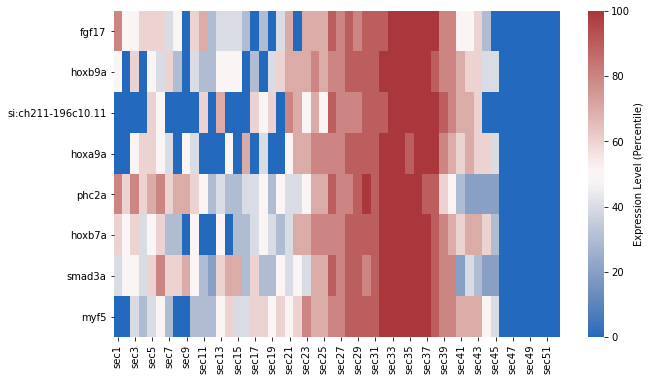

In [14]:
# Generate New DataFrame from list of genes
labelsArray = pd.DataFrame()
geneList1 = ['fgf17','hoxb9a','si:ch211-196c10.11','hoxa9a','phc2a','hoxb7a','smad3a','COL5A2 (2 of 2','myf5']

# Create new DataFrame to hold values
genePD1 = pd.DataFrame(columns=APdata.columns)
lineDF = pd.DataFrame(columns=APdata.columns)
firstline = True

# Need to build dataframe from AP for heatmaps
for geneID in geneList1:
    ensemblID = gene_mapping.loc[gene_mapping['gene']==geneID]
    lensemb_value=ensemblID.index.values
    lineDF=APdata.loc[lensemb_value,:]
    if(firstline):
        genePD1 = lineDF
        firstline = False
    else:
        genePD1 = genePD1.append(lineDF,ignore_index = False)
    
# Next Convert to Quintels to normalize the data
genePD1T = genePD1.T
quant1 = genePD1T

quant = genePD1T.quantile([.0,.1, .2, .3, .4, .5, .6, .7, .8, .9, 1.0])

# Logic loop through new dataframe and label values by percents
Cols = len(quant1.columns)
Rows = len(quant1)
p=0
q=0

while q < Cols:
    p=0
    while p < Rows:
        z = genePD1T.iloc[p][q]
        ret1 =LabelFunc2(z,q)
        # Instead of print write to excel cell 
        quant1.iloc[p][q] = ret1
        p=p+1
    q=q+1

quant1T = quant1.T
# Loop through the data source and map to the correct gene name by the ensemble ID
x = 0
indexLabels = genePD1.index.to_list()
for i, value in enumerate(genePD1.index.values):
    esmblLabel=indexLabels[i]
    labelsArray.loc[x,'gene'] = gene_mapping.loc[esmblLabel,'gene']
    x=x+1
    
y_axis_labels = labelsArray['gene'].tolist()
quant1T.index=y_axis_labels

# Now Generate Heatmap
# Generate Clustermap but focused on top 20% of releations
plt.figure(figsize=(10, 6))

p1 = sns.heatmap(quant1T, cbar_kws={'label': 'Expression Level (Percentile)'},cmap="vlag")
display(p1)


<AxesSubplot:>

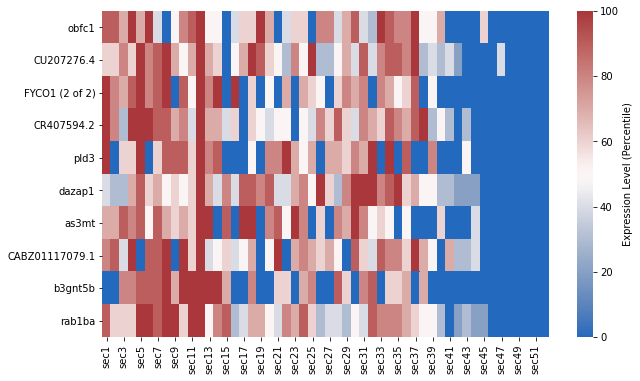

In [15]:
# Generate New DataFrame from list of genes
labelsArray = pd.DataFrame()
geneList1 = ['obfc1','CU207276.4','FYCO1 (2 of 2)','CR407594.2','pld3','dazap1','as3mt','CABZ01117079.1','b3gnt5b','rab1ba']

# Create new DataFrame to hold values
genePD1 = pd.DataFrame(columns=APdata.columns)
lineDF = pd.DataFrame(columns=APdata.columns)
firstline = True

# Need to build dataframe from AP for heatmaps
for geneID in geneList1:
    ensemblID = gene_mapping.loc[gene_mapping['gene']==geneID]
    lensemb_value=ensemblID.index.values
    lineDF=APdata.loc[lensemb_value,:]
    if(firstline):
        genePD1 = lineDF
        firstline = False
    else:
        genePD1 = genePD1.append(lineDF,ignore_index = False)
    
# Next Convert to Quintels to normalize the data
genePD1T = genePD1.T
quant1 = genePD1T

quant = genePD1T.quantile([.0,.1, .2, .3, .4, .5, .6, .7, .8, .9, 1.0])

# Logic loop through new dataframe and label values by percents
Cols = len(quant1.columns)
Rows = len(quant1)
p=0
q=0

while q < Cols:
    p=0
    while p < Rows:
        z = genePD1T.iloc[p][q]
        ret1 =LabelFunc2(z,q)
        # Instead of print write to excel cell 
        quant1.iloc[p][q] = ret1
        p=p+1
    q=q+1

quant1T = quant1.T
# Loop through the data source and map to the correct gene name by the ensemble ID
x = 0
indexLabels = genePD1.index.to_list()
for i, value in enumerate(genePD1.index.values):
    esmblLabel=indexLabels[i]
    labelsArray.loc[x,'gene'] = gene_mapping.loc[esmblLabel,'gene']
    x=x+1
    
y_axis_labels = labelsArray['gene'].tolist()
quant1T.index=y_axis_labels

# Now Generate Heatmap
# Generate Clustermap but focused on top 20% of releations
plt.figure(figsize=(10, 6))

p1 = sns.heatmap(quant1T, cbar_kws={'label': 'Expression Level (Percentile)'},cmap="vlag")
display(p1)


<AxesSubplot:>

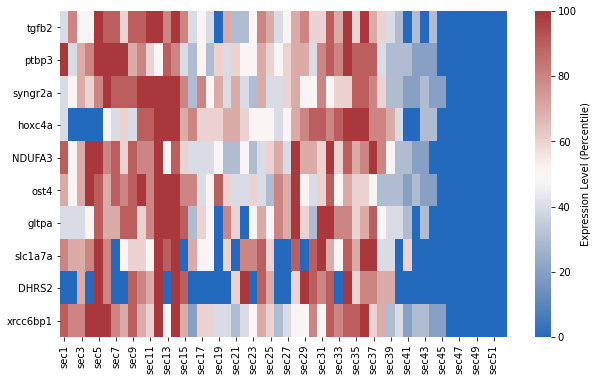

In [13]:
# Generate New DataFrame from list of genes
labelsArray = pd.DataFrame()
geneList1 = ['tgfb2','ptbp3','syngr2a','hoxc4a','NDUFA3','ost4','gltpa','slc1a7a','DHRS2','xrcc6bp1']

# Create new DataFrame to hold values
genePD1 = pd.DataFrame(columns=APdata.columns)
lineDF = pd.DataFrame(columns=APdata.columns)
firstline = True

# Need to build dataframe from AP for heatmaps
for geneID in geneList1:
    ensemblID = gene_mapping.loc[gene_mapping['gene']==geneID]
    lensemb_value=ensemblID.index.values
    lineDF=APdata.loc[lensemb_value,:]
    if(firstline):
        genePD1 = lineDF
        firstline = False
    else:
        genePD1 = genePD1.append(lineDF,ignore_index = False)
    
# Next Convert to Quintels to normalize the data
genePD1T = genePD1.T
quant1 = genePD1T

quant = genePD1T.quantile([.0,.1, .2, .3, .4, .5, .6, .7, .8, .9, 1.0])

# Logic loop through new dataframe and label values by percents
Cols = len(quant1.columns)
Rows = len(quant1)
p=0
q=0

while q < Cols:
    p=0
    while p < Rows:
        z = genePD1T.iloc[p][q]
        ret1 =LabelFunc2(z,q)
        # Instead of print write to excel cell 
        quant1.iloc[p][q] = ret1
        p=p+1
    q=q+1

quant1T = quant1.T
# Loop through the data source and map to the correct gene name by the ensemble ID
x = 0
indexLabels = genePD1.index.to_list()
for i, value in enumerate(genePD1.index.values):
    esmblLabel=indexLabels[i]
    labelsArray.loc[x,'gene'] = gene_mapping.loc[esmblLabel,'gene']
    x=x+1
    
y_axis_labels = labelsArray['gene'].tolist()
quant1T.index=y_axis_labels

# Now Generate Heatmap
# Generate Clustermap but focused on top 20% of releations
plt.figure(figsize=(10, 6))

p1 = sns.heatmap(quant1T, cbar_kws={'label': 'Expression Level (Percentile)'},cmap="vlag")
display(p1)


## Create Euclidean Distance of AP, LR, VD for secondary Validation of results

In [13]:
# Loop through the data source and map to the correct gene name by the ensemble ID
labelsArray = pd.DataFrame()
x=0

for i, value in enumerate(APdata.index.values):
    esmblLabel=indexLabels[i]
    labelsArray.loc[x,'gene'] = gene_mapping.loc[esmblLabel,'gene']
    x=x+1
y_axis_labels = labelsArray['gene'].tolist()

NameError: name 'indexLabels' is not defined

In [24]:
import xlsxwriter
# Build loop to calculate the Euclidean distance for each gene against the entire list of genes 
# and save top 10 closest for visualization.

distances = pdist(APdata, metric='euclidean')
dist_matrix = squareform(distances)

APEuc = pd.DataFrame(dist_matrix, index=y_axis_labels, columns=y_axis_labels)

# Generate for Anterior Posterior slicing
p = 1
z = 0
row_num = 0
col_num = 0

df=APEuc
# Create new Excel file below here
workbook   = xlsxwriter.Workbook('Euclidean AP.xlsx')
worksheet1 = workbook.add_worksheet('Sheet1')

# Add a header format.
header_format = workbook.add_format({
    'bold': True,
    'text_wrap': True,
    'valign': 'top',
    'fg_color': '#D7E4BC',
    'border': 1})

# Write the column headers with the defined format.
# but first set label for later indexing
# ['gene','associated_gene','pear_value','column_num','row_num']
worksheet1.write(0,0,"gene")
worksheet1.write(0,1,"associated_gene")
worksheet1.write(0,2,"ensembleID")
worksheet1.write(0,3,"euc_value")
worksheet1.write(0,4,"col_num")
worksheet1.write(0,5,"row_num")
           
# Logic
# Loop through the data source and map to the correct gene name by the ensemble ID
for col_num, value in enumerate(APEuc.columns.values):
    for row_num, value1 in enumerate(APEuc.columns.values):
        z = APEuc.iloc[row_num][col_num]
        #if (z >= 0.9):
        esmblLabel=value1
        worksheet1.write(p, 0, value) 
        worksheet1.write(p, 1, value1)
        worksheet1.write(p, 2, gene_mapping.index[row_num])
        worksheet1.write(p, 3, z)
        worksheet1.write(p, 4, col_num)
        worksheet1.write(p, 5, row_num)
        p=p+1
    
workbook.close()

In [25]:
# Loop through the data source and map to the correct gene name by the ensemble ID
labelsArray = pd.DataFrame()
x=0

for i, value in enumerate(LRdata.index.values):
    esmblLabel=indexLabels[i]
    labelsArray.loc[x,'gene'] = gene_mapping.loc[esmblLabel,'gene']
    x=x+1
y_axis_labels = labelsArray['gene'].tolist()

In [26]:
import xlsxwriter
# Build loop to calculate the Euclidean distance for each gene against the entire list of genes 
# and save top 10 closest for visualization.

distances = pdist(LRdata, metric='euclidean')
dist_matrix = squareform(distances)

LREuc = pd.DataFrame(dist_matrix, index=y_axis_labels, columns=y_axis_labels)

# Generate for Anterior Posterior slicing
p = 1
z = 0
row_num = 0
col_num = 0

# Create new Excel file below here
workbook   = xlsxwriter.Workbook('Euclidean LR.xlsx')
worksheet1 = workbook.add_worksheet('Sheet1')

# Add a header format.
header_format = workbook.add_format({
    'bold': True,
    'text_wrap': True,
    'valign': 'top',
    'fg_color': '#D7E4BC',
    'border': 1})

# Write the column headers with the defined format.
# but first set label for later indexing
# ['gene','associated_gene','pear_value','column_num','row_num']
worksheet1.write(0,0,"gene")
worksheet1.write(0,1,"associated_gene")
worksheet1.write(0,2,"ensembleID")
worksheet1.write(0,3,"euc_value")
worksheet1.write(0,4,"col_num")
worksheet1.write(0,5,"row_num")
           
# Logic
# Loop through the data source and map to the correct gene name by the ensemble ID
for col_num, value in enumerate(LREuc.columns.values):
    for row_num, value1 in enumerate(LREuc.columns.values):
        z = LREuc.iloc[row_num][col_num]
        #if (z >= 0.9):
        esmblLabel=value1
        worksheet1.write(p, 0, value) 
        worksheet1.write(p, 1, value1)
        worksheet1.write(p, 2, gene_mapping.index[row_num])
        worksheet1.write(p, 3, z)
        worksheet1.write(p, 4, col_num)
        worksheet1.write(p, 5, row_num)
        p=p+1
    
workbook.close()

In [128]:
# Loop through the data source and map to the correct gene name by the ensemble ID
labelsArray = pd.DataFrame()
x=0
indexLabels = VDdata.index.to_list()

for i, value in enumerate(VDdata.index.values):
    esmblLabel=indexLabels[i]
    labelsArray.loc[x,'gene'] = gene_mapping.loc[esmblLabel,'gene']
    x=x+1
y_axis_labels = labelsArray['gene'].tolist()

In [28]:
import xlsxwriter
# Build loop to calculate the Euclidean distance for each gene against the entire list of genes 
# and save top 10 closest for visualization.

distances = pdist(VDdata, metric='euclidean')
dist_matrix = squareform(distances)

VDEuc = pd.DataFrame(dist_matrix, index=y_axis_labels, columns=y_axis_labels)

# Generate for Anterior Posterior slicing
p = 1
z = 0
row_num = 0
col_num = 0

# Create new Excel file below here
workbook   = xlsxwriter.Workbook('Euclidean VD.xlsx')
worksheet1 = workbook.add_worksheet('Sheet1')

# Add a header format.
header_format = workbook.add_format({
    'bold': True,
    'text_wrap': True,
    'valign': 'top',
    'fg_color': '#D7E4BC',
    'border': 1})

# Write the column headers with the defined format.
# but first set label for later indexing
# ['gene','associated_gene','pear_value','column_num','row_num']
worksheet1.write(0,0,"gene")
worksheet1.write(0,1,"associated_gene")
worksheet1.write(0,2,"ensembleID")
worksheet1.write(0,3,"euc_value")
worksheet1.write(0,4,"col_num")
worksheet1.write(0,5,"row_num")
           
# Logic
# Loop through the data source and map to the correct gene name by the ensemble ID
for col_num, value in enumerate(VDEuc.columns.values):
    for row_num, value1 in enumerate(VDEuc.columns.values):
        z = VDEuc.iloc[row_num][col_num]
        #if (z >= 0.9):
        esmblLabel=value1
        worksheet1.write(p, 0, value) 
        worksheet1.write(p, 1, value1)
        worksheet1.write(p, 2, gene_mapping.index[row_num])
        worksheet1.write(p, 3, z)
        worksheet1.write(p, 4, col_num)
        worksheet1.write(p, 5, row_num)
        p=p+1
    
workbook.close()

# Run Point 2 - Run next 2 sections
## Then goto Run Point 3

In [16]:
# Read the  results for sections above.
APEcudata = pd.read_excel("Euclidean AP.xlsx",sheet_name='Sheet1')
LREcudata = pd.read_excel("Euclidean LR.xlsx",sheet_name='Sheet1')
VDEcudata = pd.read_excel("Euclidean VD.xlsx",sheet_name='Sheet1')

In [17]:
# Now sort by gene then person value.
# This will allow the selection of a gene, then show associated genes by closest distance
APEcudata = APEcudata.sort_values(by=['gene','euc_value'],ascending=[True,True])
LREcudata = LREcudata.sort_values(by=['gene','euc_value'],ascending=[True,True])
VDEcudata = VDEcudata.sort_values(by=['gene','euc_value'],ascending=[True,True])

newdata = APEcudata.query('gene=="actn3b"')
display(newdata.head(n=11))

,gene,associated_gene,ensembleID,euc_value,col_num,row_num
732220,actn3b,actn3b,ENSDARG00000001431,0.000000,62,62
742516,actn3b,SYNPO2 (2 of 2),ENSDARG00000079675,14.731351,62,10358
736012,actn3b,mboat2a,ENSDARG00000031845,14.854686,62,3854
739631,actn3b,si:dkey-106c17.3,ENSDARG00000059747,15.482800,62,7473
734848,actn3b,angptl6,ENSDARG00000020265,15.621719,62,2690
738719,actn3b,loxl1,ENSDARG00000054451,15.817070,62,6561
736008,actn3b,rbm24b,ENSDARG00000031809,16.335569,62,3850
741585,actn3b,mss51,ENSDARG00000075463,16.399762,62,9427
734999,actn3b,mybpc2b,ENSDARG00000021265,16.403387,62,2841
736800,actn3b,atoh8,ENSDARG00000037555,16.461455,62,4642


In [18]:

sns.set(context="notebook", palette="Spectral", style = 'darkgrid' ,font_scale = 1.5, color_codes=True)

X = APqdataT.to_numpy()
#display(X)
from sklearn.cluster import KMeans
wcss = []
for i in range(1, 52):
    kmeans = KMeans(n_clusters = i, init = 'k-means++', random_state = 42)
    kmeans.fit(X)
# inertia method returns wcss for that model
    wcss.append(kmeans.inertia_)
plt.figure(figsize=(10,5))


# Using the elbow method to find the optimal number of clusters
sns.lineplot(range(1, 52), wcss,marker='o',color='red')
plt.title('The Elbow Method')
plt.xlabel('Number of clusters')
plt.ylabel('')
plt.show()

kmeans = KMeans(n_clusters = 5, init = 'k-means++', random_state = 42)
y_kmeans = kmeans.fit_predict(X)

#Visualising the clusters
plt.figure(figsize=(15,7))
sns.scatterplot(X[y_kmeans == 0, 0], X[y_kmeans == 0, 1], color = 'yellow', label = 'Cluster 1',s=52)
sns.scatterplot(X[y_kmeans == 1, 0], X[y_kmeans == 1, 1], color = 'blue', label = 'Cluster 2',s=52)
sns.scatterplot(X[y_kmeans == 2, 0], X[y_kmeans == 2, 1], color = 'green', label = 'Cluster 3',s=52)
sns.scatterplot(X[y_kmeans == 3, 0], X[y_kmeans == 3, 1], color = 'grey', label = 'Cluster 4',s=52)
sns.scatterplot(X[y_kmeans == 4, 0], X[y_kmeans == 4, 1], color = 'orange', label = 'Cluster 5',s=52)
sns.scatterplot(kmeans.cluster_centers_[:, 0], kmeans.cluster_centers_[:, 1], color = 'red',
label = 'Centroids',s=300,marker=',')
plt.grid(False)
plt.title('Clusters of Genes')
plt.xlabel('Sections')
plt.ylabel('Expression')
plt.legend()
plt.show()

NameError: name 'APqdataT' is not defined

# Run Point 3 - run all below

In [40]:
# Open and Read Quantiles.xlsx
import pandas as pd

APqdata = pd.read_excel("transposed_output.xlsx",sheet_name='Sheet1')
LRqdata = pd.read_excel("transposed_output.xlsx",sheet_name='Sheet2')
VDqdata = pd.read_excel("transposed_output.xlsx",sheet_name='Sheet3')
Distdata = pd.read_excel("distance_output.xlsx",sheet_name='Sheet1')

# set index to and axis to gene
APqdata.rename(columns={APqdata.columns[0]:'Section'},inplace=True)
APqdata.index = APqdata['Section']
APqdata = APqdata.drop('Section', axis=1)

LRqdata.rename(columns={LRqdata.columns[0]:'Section'},inplace=True)
LRqdata.index = LRqdata['Section']
LRqdata = LRqdata.drop('Section', axis=1)

VDqdata.rename(columns={VDqdata.columns[0]:'Section'},inplace=True)
VDqdata.index = VDqdata['Section']
VDqdata = VDqdata.drop('Section', axis=1)

#Transpose qdata
APqdataT = APqdata.T
LRqdataT = LRqdata.T
VDqdataT = VDqdata.T

In [41]:
APSect = APqdataT['sec2'].to_list()
LRSect = LRqdataT['sec2'].to_list()
VDSect = VDqdataT['sec2'].to_list()

#display(APSect)

In [42]:
# Build loop to calculate the Euclidean distance for each gene against the entire list of genes 
# and save top 10 closest for visualization.

distances = pdist(APqdata, metric='euclidean')
APEuc = pd.DataFrame(distances)
#dist_matrix = squareform(distances)

#VDEuc = pd.DataFrame(dist_matrix, index=y_axis_labels, columns=y_axis_labels)

display(APEuc.head(n=11))

,0
0,21995.624455
1,5930.930708
2,9316.379509
3,15207.651652
4,32633.824793
5,9913.313219
6,8301.323308
7,18927.205904
8,15817.357773
9,12200.348607


In [16]:
# Generate New DataFrame from list of genes
labelsArray = pd.DataFrame()
#geneList1 = ['fgf17','hoxb9a','si:ch211-196c10.11','hoxa9a','phc2a','hoxb7a','smad3a','COL5A2 (2 of 2)','myf5']
newdata = APEcudata.query('gene=="actn3b"')
geneList1 = newdata['associated_gene'].head(n=11).to_list()

# Create new DataFrame to hold values
genePD1 = pd.DataFrame(columns=APqdata.columns)
lineDF = pd.DataFrame(columns=APqdata.columns)
firstline = True

# Need to build dataframe from AP for heatmaps
for geneID in geneList1:
    ensemblID = gene_mapping.loc[gene_mapping['gene']==geneID]
    lensemb_value=ensemblID.index.values
    lineDF=APqdataT.loc[lensemb_value,:]
    if(firstline):
        genePD1 = lineDF
        firstline = False
    else:
        genePD1 = genePD1.append(lineDF,ignore_index = False)

genePD1.index = geneList1

# Set frequency of x tick marks
p=0
xticks_label = pd.DataFrame(columns=['label'])
for col_num, value in enumerate(genePD1.index.values):
    if(col_num%2):
        xticks_label.loc[p] = [value]
        p=p+1

genePD1T = genePD1.T
# Set Tick Labels        
label_list = [1,3,5,7,9,11,13,15,17,19,21,23,25,27,29,31,33,35,37,39,41,43,45,47,49,51]
markers=['o','d','s']
genePD1T.plot(figsize=(20,10),grid=True,xticks=label_list,marker='o', ylabel="Expression Levels")
plt.show()

NameError: name 'APEcudata' is not defined

In [ ]:
import math
import numpy as np

dist1 = math.sqrt((0.4-2.53)**2+(0-0)**2+(0-0.65)**2)
display(dist1)

a = np.array((0.4,0,0))
b = np.array((2.53,0,0.65))

dist1 = np.linalg.norm(a-b)
display(dist1)

ThreeDplt = pd.DataFrame(columns=["AP","LR","VD"])
ThreeDplt['AP'] = APSect
ThreeDplt['LR'] = LRSect
ThreeDplt['VD'] = VDSect
ThreeDplt.index = gene_mapping.index
y_axis_labels = ThreeDplt.index.to_list()
dist2 = pdist(ThreeDplt, metric='euclidean')
dist_matrix = squareform(dist2)

SecEuc = pd.DataFrame(dist_matrix, index=y_axis_labels, columns=y_axis_labels)
display(SecEuc.loc['ENSDARG00000001431','ENSDARG00000094324'])


In [24]:
import xlsxwriter
# Build loop to calculate the Euclidean distance for each gene against the entire list of genes 
# and save top 10 closest for visualization.
# Loop through the data source and map to the correct gene name by the ensemble ID
labelsArray = pd.DataFrame()
x=0
indexLabels = VDdata.index.to_list()

for i, value in enumerate(APqdataT.index.values):
    esmblLabel=indexLabels[i]
    labelsArray.loc[x,'gene'] = gene_mapping.loc[esmblLabel,'gene']
    x=x+1
y_axis_labels = labelsArray['gene'].tolist()

VDEuc = pd.DataFrame(dist_matrix, index=y_axis_labels, columns=y_axis_labels)

# Generate for Anterior Posterior slicing
p = 1
z = 0
row_num = 0
col_num = 0

# Create new Excel file below here
workbook   = xlsxwriter.Workbook('Sect2.xlsx')
worksheet1 = workbook.add_worksheet('Sheet1')

# Add a header format.
header_format = workbook.add_format({
    'bold': True,
    'text_wrap': True,
    'valign': 'top',
    'fg_color': '#D7E4BC',
    'border': 1})

# Write the column headers with the defined format.
# but first set label for later indexing
# ['gene','associated_gene','pear_value','column_num','row_num']
worksheet1.write(0,0,"gene")
worksheet1.write(0,1,"associated_gene")
worksheet1.write(0,2,"ensembleID")
worksheet1.write(0,3,"euc_value")
worksheet1.write(0,4,"col_num")
worksheet1.write(0,5,"row_num")
           
# Logic
# Loop through the data source and map to the correct gene name by the ensemble ID
for col_num, value in enumerate(VDEuc.columns.values):
    for row_num, value1 in enumerate(VDEuc.columns.values):
        z = SecEuc.iloc[row_num][col_num]
        #if (z >= 0.9):
        esmblLabel=value1
        worksheet1.write(p, 0, value) 
        worksheet1.write(p, 1, value1)
        worksheet1.write(p, 2, gene_mapping.index[row_num])
        worksheet1.write(p, 3, z)
        worksheet1.write(p, 4, col_num)
        worksheet1.write(p, 5, row_num)
        p=p+1
    
workbook.close()

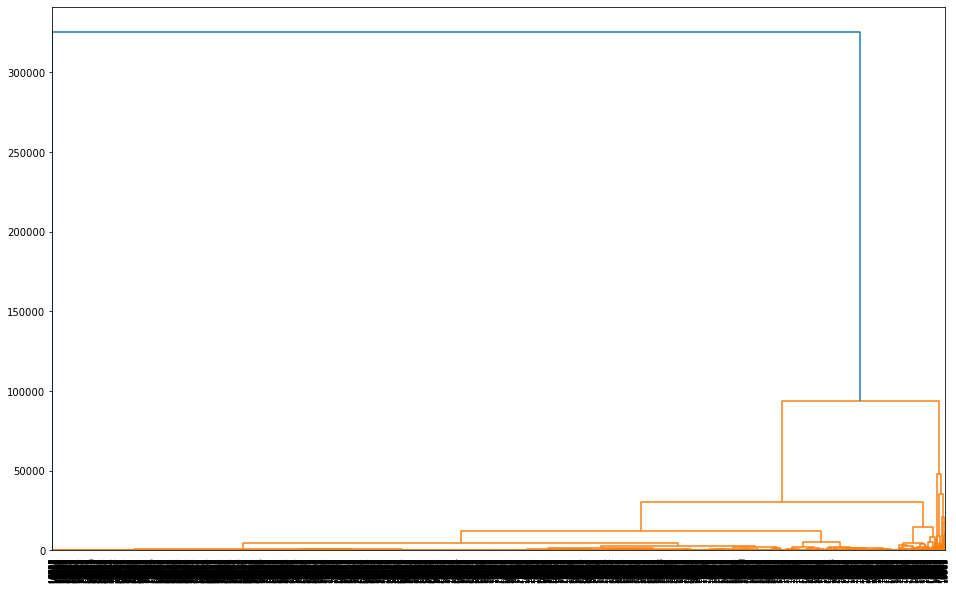

array([0, 0, 0, ..., 0, 0, 0])

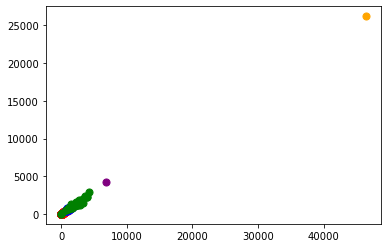

In [35]:
import scipy.cluster.hierarchy as sch

plt.figure(figsize=(16,10))
X = APqdataT.to_numpy()

dendrogram = sch.dendrogram(sch.linkage(X, method='ward'),leaf_rotation=90,leaf_font_size=8)
plt.show()

model = AgglomerativeClustering(n_clusters=5, affinity='euclidean', linkage='ward')
model.fit(X)
labels = model.labels_
display(labels)

plt.scatter(X[labels==0, 0], X[labels==0, 1], s=50, marker='o', color='red')
plt.scatter(X[labels==1, 0], X[labels==1, 1], s=50, marker='o', color='blue')
plt.scatter(X[labels==2, 0], X[labels==2, 1], s=50, marker='o', color='green')
plt.scatter(X[labels==3, 0], X[labels==3, 1], s=50, marker='o', color='purple')
plt.scatter(X[labels==4, 0], X[labels==4, 1], s=50, marker='o', color='orange')
plt.show()

In [ ]:
from sklearn.cluster import KMeans

#Y = np.array([APqdata, LRqdata,VDqdata])
Y = np.array(APqdata, LRqdata)
#kmeans = KMeans(n_clusters=5)
#kmeans = kmeans.fit(Y)

X=Y
model = AgglomerativeClustering(n_clusters=5, affinity='euclidean', linkage='ward')
model.fit(X)
labels = model.labels_
display(labels)

plt.scatter(X[labels==0, 0], X[labels==0, 1], s=50, marker='o', color='red')
plt.scatter(X[labels==1, 0], X[labels==1, 1], s=50, marker='o', color='blue')
plt.scatter(X[labels==2, 0], X[labels==2, 1], s=50, marker='o', color='green')
plt.scatter(X[labels==3, 0], X[labels==3, 1], s=50, marker='o', color='purple')
plt.scatter(X[labels==4, 0], X[labels==4, 1], s=50, marker='o', color='orange')
plt.show()